# Enunciado

### Descripcion

En este problema, se proporciona un conjunto de datos que contiene imágenes de escenas naturales de todo el mundo. El objetivo es construir un modelo de clasificación utilizando redes neuronales convolucionales (CNN) para clasificar estas imágenes en una de las seis categorías predefinidas.

### Dataset

El dataset proporcionado contiene alrededor de 25,000 imágenes de tamaño 150x150, distribuidas en seis categorías:
- buildings
- forest
- glacier
- mountain
- sea
- street

Las imágenes están divididas en tres conjuntos:
- Train: Alrededor de 14,000 imágenes para entrenamiento.
- Test: Alrededor de 3,000 imágenes para evaluación del modelo.
- Prediction: Alrededor de 7,000 imágenes para predicción final.


### Objetivo

Utilizando el dataset proporcionado, el objetivo es construir y comparar el rendimiento de distintos modelos de clasificación de imágenes utilizando redes neuronales convolucionales y densas que puedan clasificar con precisión las imágenes de escenas naturales en una de las seis categorías mencionadas anteriormente.

Los modelos a diseñar son:
- Modelo con capas densas.
- Modelo con capas convolucionales y densas.
- Modelo que incluya bloques residuales identidad.
- Modelo que utilice como backbone alguna de las arquitecturas disponibles en TensorFlow (transfer learning): https://www.tensorflow.org/api_docs/python/tf/keras/applications

Se debe entrenar y evaluar cada modelo utilizando técnicas adecuadas de validación y métricas de evaluación de clasificación.



# Resolución

## Entorno

In [47]:
!cd /content
!git clone https://github.com/amaranto/aa2

fatal: destination path 'aa2' already exists and is not an empty directory.


In [54]:
import os
import subprocess
import zipfile
from pathlib import Path
import sys

import numpy as np
import tensorflow as tf
from keras.callbacks import EarlyStopping

sys.path.append('/content/aa2/ej3')

import matplotlib.pyplot as plt
from plots import plot_fit, plot_predictions

import convXdense as cxd
import dense
import resnet3
import transfer

In [51]:
DS_DESTINATION="/content/TP1-3-natural-scenes.zip"
DS_UNZIP_DEST=DS_DESTINATION.replace(".zip","")
DS_DRIVE_ID="1Pqs5Y6dZr4R66Dby5hIUIjPZtBI28rmJ"
TRAIN_DIRECTORY = Path("/content/TP1-3-natural-scenes/seg_train/seg_train/")
TEST_DIRECTORY = Path("/content/TP1-3-natural-scenes/seg_test/seg_test/")
PRED_IMAGES_DIRECTORY = Path("/content/TP1-3-natural-scenes/seg_pred/seg_pred/")
BATCH_SIZE = 150
IMAGE_HEIGHT = 150
IMAGE_WIDTH = 150

## Datasets

In [9]:
if not os.path.isfile(DS_DESTINATION):
    print(subprocess.run(["gdown", DS_DRIVE_ID,
                          "-O",
                          DS_DESTINATION],
                          capture_output=True))

    with zipfile.ZipFile(DS_DESTINATION, 'r') as zip_ref:
        zip_ref.extractall(DS_UNZIP_DEST)

    for DIR in [TRAIN_DIRECTORY,TEST_DIRECTORY ] :
        path, directories, files = [ (p, d, f) for p,d,f in os.walk(DIR)][0]
        root_path = str(path)
        labels = directories

        for label in labels:
            current_dir = os.path.join(root_path, label)
            print(f"Working on dir {label} on {path}")
            for path, directories, image_files in os.walk(str(current_dir)):
                for image_file in image_files:
                    current_name = os.path.join(current_dir, image_file)
                    new_name = os.path.join(current_dir, label + "_" + image_file)
                    os.rename(current_name, new_name)

In [19]:
# Carga los datos de entrenamiento y validación
train_ds = tf.keras.utils.image_dataset_from_directory(
    TRAIN_DIRECTORY,
    validation_split=0.2,
    subset="training",
    label_mode="categorical",
    seed=123,
    image_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    TEST_DIRECTORY,
    validation_split=0.2,
    subset="validation",
    label_mode="categorical",
    seed=123,
    image_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE
)

# Obtiene los nombres de las clases
class_names = train_ds.class_names
num_classes = len(class_names)
class_lens = {}
val_lens = {}

for c in class_names:
    train_dir = TRAIN_DIRECTORY.joinpath(c)
    val_dir = TEST_DIRECTORY.joinpath(c)
    class_lens[c] = len([name for name in os.listdir(train_dir)])
    val_lens[c] = len([name for name in os.listdir(val_dir)])

print(f"Train: {class_lens}")
print(f"Test:{val_lens}")

Found 14034 files belonging to 6 classes.
Using 11228 files for training.
Found 3000 files belonging to 6 classes.
Using 600 files for validation.
Train: {'buildings': 2191, 'forest': 2271, 'glacier': 2404, 'mountain': 2512, 'sea': 2274, 'street': 2382}
Test:{'buildings': 437, 'forest': 474, 'glacier': 553, 'mountain': 525, 'sea': 510, 'street': 501}


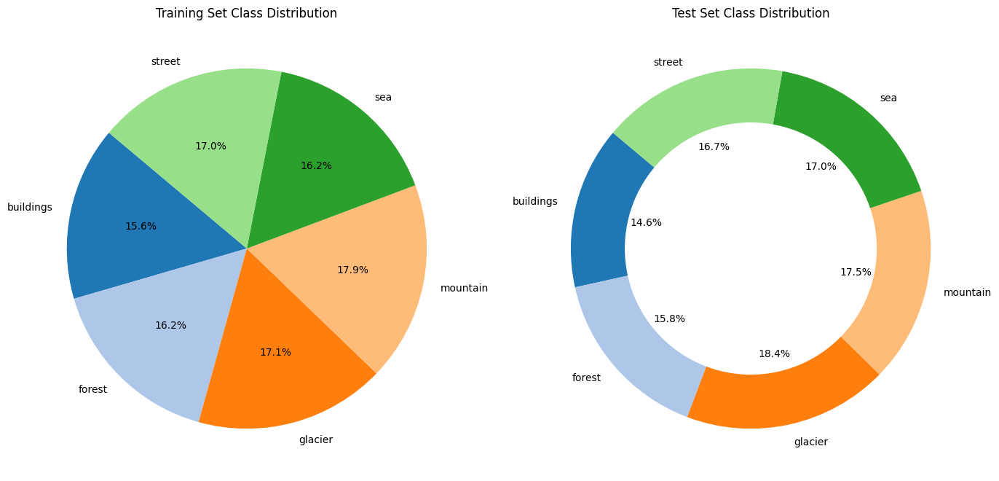

In [20]:
fig, ax = plt.subplots(1, 2, figsize=(14, 7), subplot_kw=dict(aspect="equal"))

train_sizes = list(class_lens.values())
train_labels = list(class_lens.keys())

test_sizes = list(val_lens.values())
test_labels = list(val_lens.keys())

colors = plt.get_cmap("tab20").colors

# Donut plot for training set
ax[0].pie(train_sizes, labels=train_labels, autopct='%1.1f%%', startangle=140, colors=colors)
ax[0].set_title("Training Set Class Distribution")

# Donut plot for test set
ax[1].pie(test_sizes, labels=test_labels, autopct='%1.1f%%', startangle=140, colors=colors)
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig.gca().add_artist(centre_circle)
ax[1].set_title("Test Set Class Distribution")

plt.tight_layout()
plt.show()

<Figure size 1000x1000 with 0 Axes>

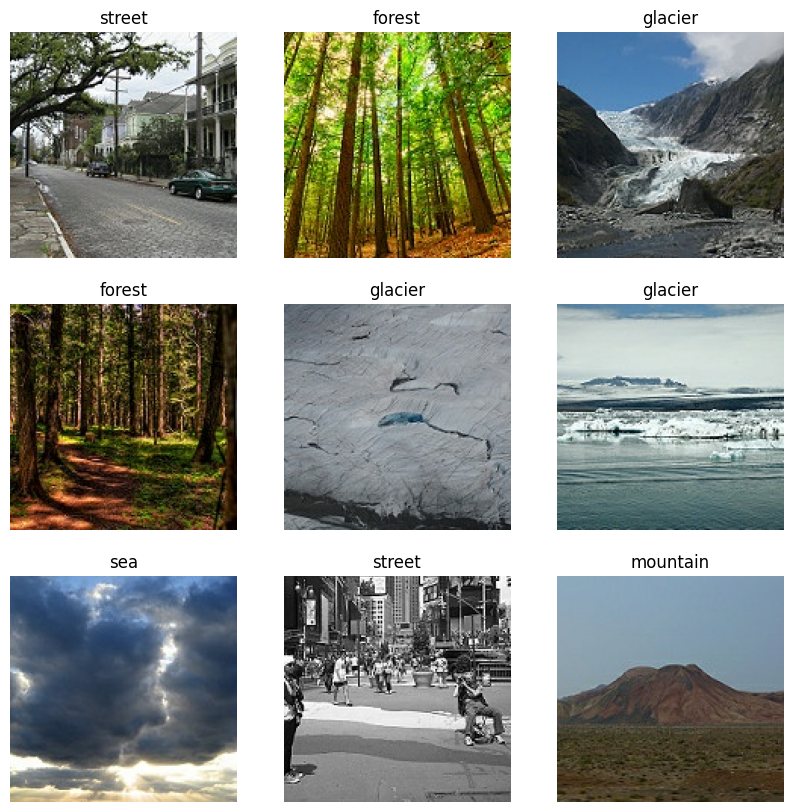

In [11]:
plt.figure(figsize=(10, 10))

for images, labels in val_ds.take(1):
  plt.figure(figsize=(10, 10))
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    class_idx = list(labels[i]).index(1)

    plt.title(class_names[class_idx])
    plt.axis("off")

## Modelo con capas convolucionales y densas

In [23]:
!cat /content/aa2/ej3/convXdense.py

import tensorflow as tf
from keras.layers import Input, RandomFlip, RandomContrast, BatchNormalization, RandomTranslation, Flatten, Dropout
from keras.layers import Dense, Conv2D, Activation, MaxPooling2D, GlobalMaxPooling2D, Rescaling

def build_model(input_shape, output_labels):
    i = Input(input_shape, dtype=tf.float32)

    x = Rescaling(1./255)(i)
    x = RandomFlip("horizontal")(x)
    x = RandomFlip("vertical")(x)
    x = RandomTranslation(0.1, 0.1, fill_mode="reflect")(x)
    x = RandomContrast(0.2)(x)

    x = Conv2D(8, (3, 3))(x)
    x = Activation("relu")(x)

    x = Conv2D(16, (3, 3))(x)
    x = Activation("relu")(x)

    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(32, (3, 3))(x)
    x = Activation("relu")(x)

    x = MaxPooling2D((2, 2))(x)

    x = Conv2D(64, (3, 3))(x)
    x = Activation("relu")(x)

    x = MaxPooling2D((2, 2))(x)

    x = Flatten()(x)
    x = Dropout(0.3)(x)
    x = Dense(output_labels)(x)
    x = Activation("softmax")(x)
    
    return tf.keras.Mode

In [21]:
print("Building model Convulotion and Dense layers")
cxd_model = cxd.build_model((IMAGE_HEIGHT, IMAGE_WIDTH, 3), num_classes)

cxd_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])

Building model Convulotion and Dense layers


In [22]:
EPOCHS = 30

history = cxd_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/30
75/75 [==============================] - 22s 150ms/step - loss: 1.3552 - accuracy: 0.4450 - val_loss: 1.1998 - val_accuracy: 0.5117
Epoch 2/30
75/75 [==============================] - 10s 125ms/step - loss: 1.0988 - accuracy: 0.5595 - val_loss: 1.0013 - val_accuracy: 0.6117
Epoch 3/30
75/75 [==============================] - 8s 104ms/step - loss: 0.9418 - accuracy: 0.6429 - val_loss: 0.9638 - val_accuracy: 0.6000
Epoch 4/30
75/75 [==============================] - 11s 134ms/step - loss: 0.8505 - accuracy: 0.6860 - val_loss: 0.8178 - val_accuracy: 0.6817
Epoch 5/30
75/75 [==============================] - 11s 116ms/step - loss: 0.8056 - accuracy: 0.7024 - val_loss: 0.7000 - val_accuracy: 0.7333
Epoch 6/30
75/75 [==============================] - 10s 121ms/step - loss: 0.7514 - accuracy: 0.7240 - val_loss: 0.7108 - val_accuracy: 0.7283
Epoch 7/30
75/75 [==============================] - 9s 115ms/step - loss: 0.7220 - accuracy: 0.7397 - val_loss: 0.7190 - val_accuracy: 0.6967
E

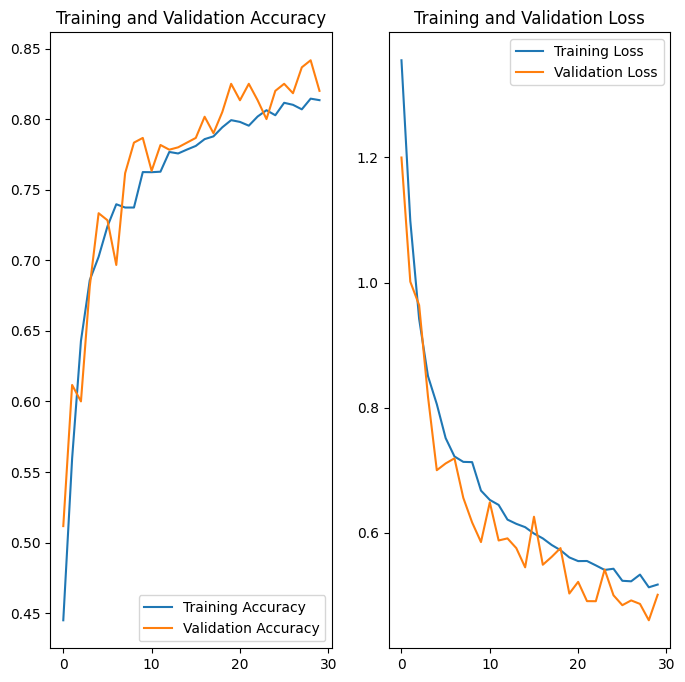

In [30]:
plot_fit(history, epochs=EPOCHS)

1/1 [==============================] - 0s 20ms/step
[[2.4678432e-03 9.8255157e-01 3.2544226e-04 2.1451793e-03 8.8473512e-03
  3.6626616e-03]]
1/1 [==============================] - 0s 17ms/step
[[5.6179613e-02 9.1392702e-01 2.9603639e-04 2.6654924e-04 1.7276338e-03
  2.7603207e-02]]
1/1 [==============================] - 0s 18ms/step
[[3.5506557e-04 9.8778486e-01 3.0791685e-03 8.5383561e-03 1.9957664e-04
  4.2993863e-05]]
1/1 [==============================] - 0s 19ms/step
[[6.2027678e-02 3.9973180e-05 1.0164403e-05 3.2274151e-08 1.0602899e-06
  9.3792111e-01]]
1/1 [==============================] - 0s 17ms/step
[[5.1399834e-02 4.4955043e-05 7.6893806e-01 1.4962143e-01 2.9614473e-02
  3.8130209e-04]]
1/1 [==============================] - 0s 17ms/step
[[7.3017347e-01 1.7515162e-04 3.2983292e-03 2.3464146e-03 7.7418648e-03
  2.5626484e-01]]
1/1 [==============================] - 0s 23ms/step
[[5.9352750e-01 9.9604469e-05 7.0390734e-04 5.7653353e-05 3.7509897e-01
  3.0512350e-02]]
1/1 [=

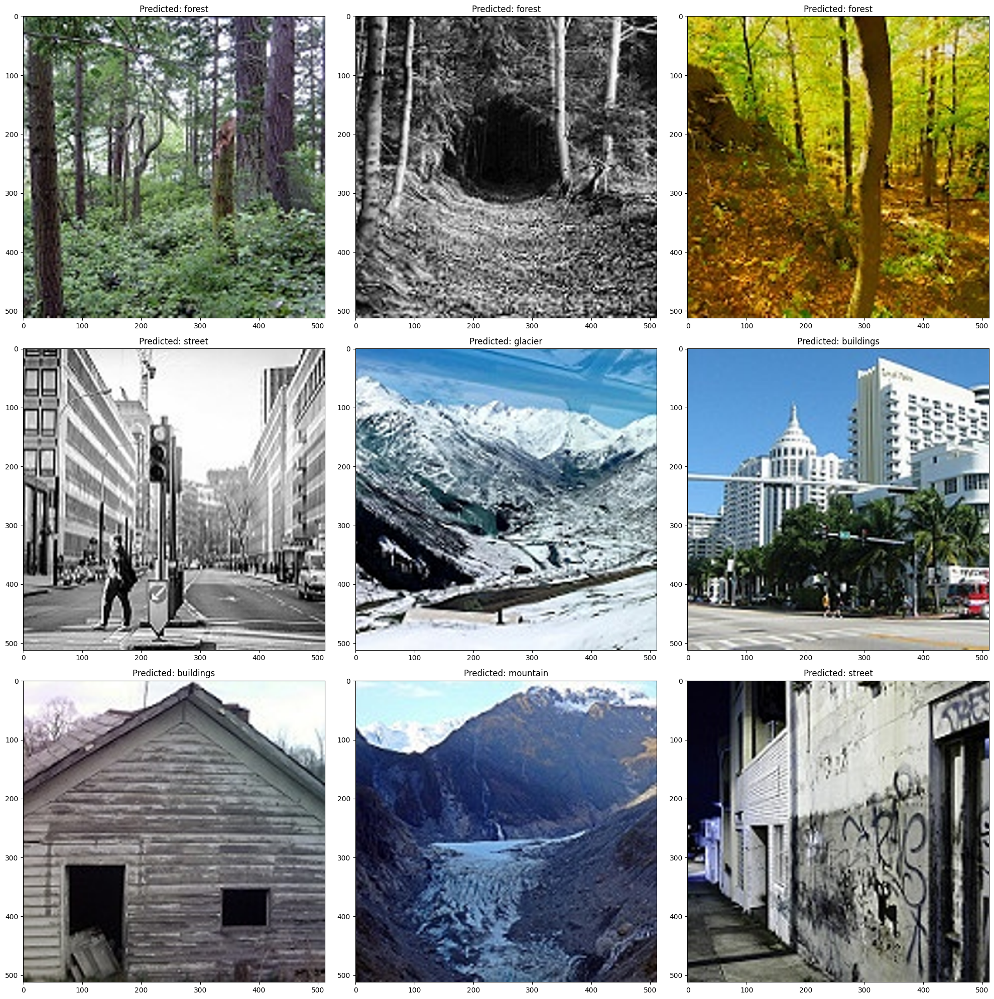

In [38]:
plot_predictions(
    cxd_model,
    PRED_IMAGES_DIRECTORY,
    class_names,
    sx=3,
    sy=3,
    figsize=(20, 20)
)

El modelo de clasificación que utiliza tanto capas convolucionales como densas logra un rendimiento considerablemente sólido, con una precisión cercana al 80% en tanto el conjunto de entrenamiento como el de prueba después de 30 épocas de entrenamiento.

La arquitectura empleada parece ser efectiva en la extracción y abstracción de características relevantes de las imágenes, lo que resulta en una clasificación precisa de las escenas naturales en seis categorías predefinidas.

Sin embargo, se observa cierto ruido durante el entrenamiento hasta que el modelo converge, lo que sugiere posibles áreas de mejora en la estabilidad del entrenamiento.

## Modelo de capas densas

In [45]:
!cat /content/aa2/ej3/dense.py

import tensorflow as tf
from keras.layers import Input, RandomFlip, RandomContrast, BatchNormalization, RandomTranslation, Flatten, Dropout
from keras.layers import Dense, Conv2D, Activation, MaxPooling2D, GlobalMaxPooling2D, Rescaling

def build_model(input_shape, output_labels):
    i = Input(input_shape, dtype=tf.float32)

    x = Rescaling(1./255)(i)
    x = RandomFlip("horizontal")(x)
    x = RandomFlip("vertical")(x)
    x = RandomTranslation(0.1, 0.1, fill_mode="reflect")(x)
    x = RandomContrast(0.2)(x)

    x = Flatten()(x)
    x = Dense(512)(x)
    x = Activation("relu")(x)

    x = Dense(256)(x)
    x = Activation("relu")(x)

    x = Dense(128)(x)
    x = Activation("relu")(x)

    x = Dense(output_labels)(x)
    x = Activation("softmax")(x)
    return tf.keras.Model(inputs=[i], outputs=[x])

In [39]:
print("Building model Convulotion and Dense layers")
dense_model = dense.build_model((IMAGE_HEIGHT, IMAGE_WIDTH, 3), num_classes)

dense_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy']
)

dense_model.summary()

Building model Convulotion and Dense layers
Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 rescaling_1 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 random_flip_2 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 random_flip_3 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 random_translation_1 (Rand  (None, 150, 150, 3)       0         
 omTranslation)                                                  
                                                                 
 random_contrast_1 (RandomC  (None, 150, 150, 3)       0         
 ontrast)      

In [40]:
history = dense_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/30
75/75 [==============================] - 9s 86ms/step - loss: 8.5566 - accuracy: 0.2783 - val_loss: 1.6008 - val_accuracy: 0.3833
Epoch 2/30
75/75 [==============================] - 6s 69ms/step - loss: 1.5890 - accuracy: 0.3967 - val_loss: 1.3779 - val_accuracy: 0.4983
Epoch 3/30
75/75 [==============================] - 6s 80ms/step - loss: 1.5044 - accuracy: 0.4322 - val_loss: 1.3657 - val_accuracy: 0.4683
Epoch 4/30
75/75 [==============================] - 8s 101ms/step - loss: 1.5091 - accuracy: 0.4353 - val_loss: 1.4538 - val_accuracy: 0.4900
Epoch 5/30
75/75 [==============================] - 8s 97ms/step - loss: 1.5102 - accuracy: 0.4421 - val_loss: 1.3337 - val_accuracy: 0.4783
Epoch 6/30
75/75 [==============================] - 6s 80ms/step - loss: 1.3940 - accuracy: 0.4671 - val_loss: 1.3034 - val_accuracy: 0.5067
Epoch 7/30
75/75 [==============================] - 8s 98ms/step - loss: 1.3339 - accuracy: 0.4891 - val_loss: 1.3025 - val_accuracy: 0.5117
Epoch 8/30
7

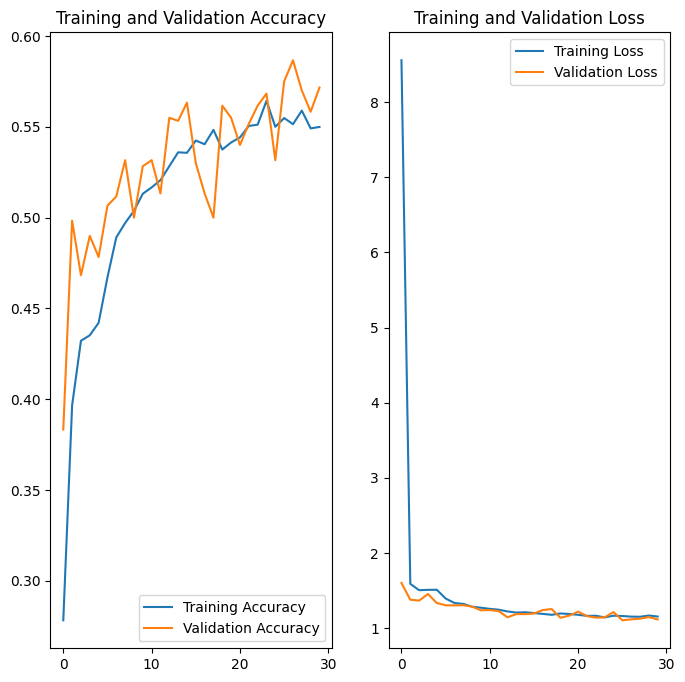

In [41]:
plot_fit(history, epochs=EPOCHS)

1/1 [==============================] - 0s 17ms/step
[[0.11469179 0.47847292 0.13034546 0.02651019 0.1667295  0.08325016]]
1/1 [==============================] - 0s 16ms/step
[[0.14714885 0.09280209 0.12712248 0.11955166 0.30634466 0.20703028]]
1/1 [==============================] - 0s 16ms/step
[[8.9537913e-05 9.9256527e-01 6.7145526e-03 3.1280189e-04 3.0078107e-04
  1.7080854e-05]]
1/1 [==============================] - 0s 21ms/step
[[0.16187166 0.01734088 0.42972514 0.04005532 0.13874465 0.21226229]]
1/1 [==============================] - 0s 17ms/step
[[0.03722226 0.00085019 0.72579014 0.10118011 0.11616784 0.01878951]]
1/1 [==============================] - 0s 21ms/step
[[0.28215036 0.00113968 0.14349166 0.26897234 0.29600117 0.00824477]]
1/1 [==============================] - 0s 23ms/step
[[0.7482161  0.00840012 0.03462104 0.08326583 0.06578587 0.05971104]]
1/1 [==============================] - 0s 23ms/step
[[0.11725672 0.0028719  0.3308671  0.26912    0.23954515 0.04033913]]
1/1 

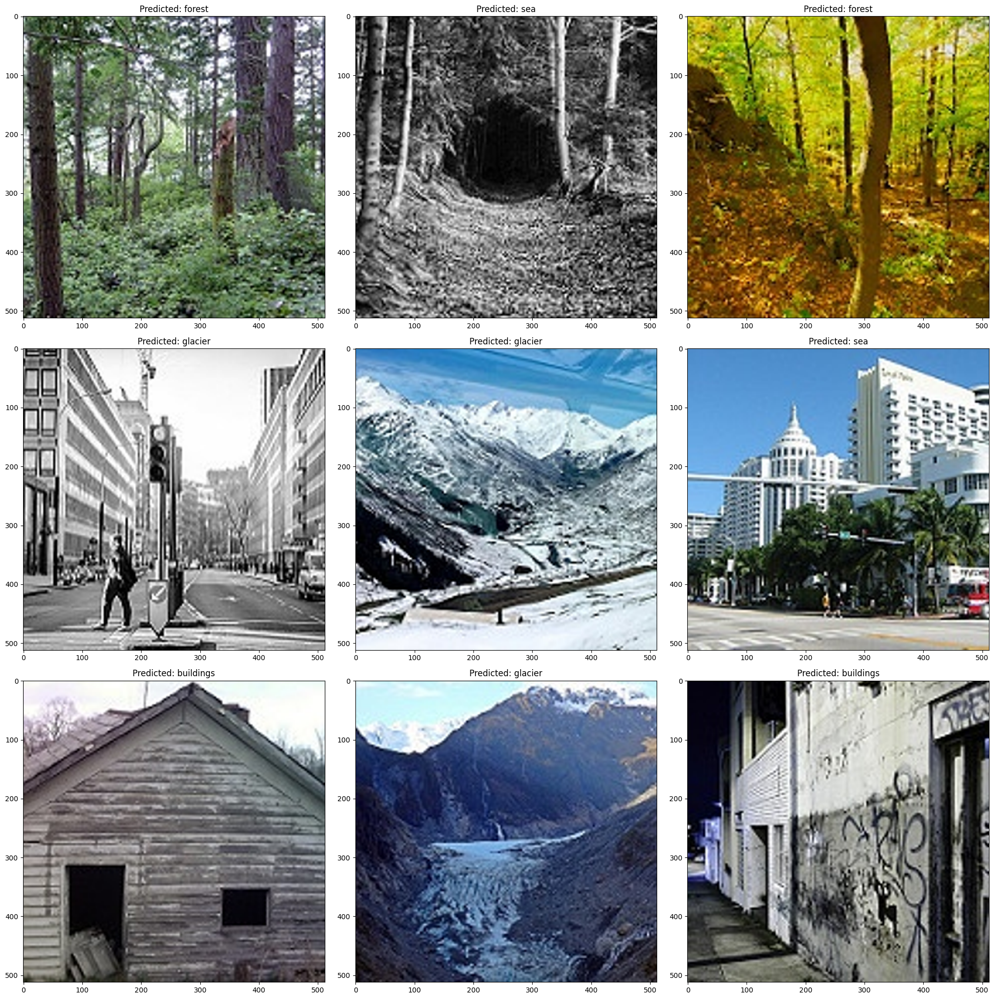

In [43]:
plot_predictions(
    dense_model,
    PRED_IMAGES_DIRECTORY,
    class_names,
    sx=3,
    sy=3,
    figsize=(20, 20)
)

El modelo basado únicamente en capas densas muestra un rendimiento significativamente inferior en comparación con el modelo que combina capas convolucionales y densas.

Los gráficos de entrenamiento y validación del accuracy y loss son notablemente más ruidosos, indicando una mayor variabilidad en el rendimiento del modelo durante el entrenamiento.

Además, los valores de precisión son sustancialmente más bajos, aproximadamente alrededor del 55% tanto en el conjunto de entrenamiento como en el de prueba, mientras que la pérdida alcanza valores más altos, convergiendo hacia alrededor de 1.15.

Esto significa que la arquitectura de este modelo es inferior para realizar una terea de clasificación de imagenes como estas, y las capas convoluciones aportan gran valor para mejorar esta arquitectura.

## Modelo de bloques residuales

In [59]:
!cat /content/aa2/ej3/resnet3.py

import tensorflow as tf
from keras.layers import Input, RandomFlip, RandomContrast, BatchNormalization, RandomTranslation, Flatten, Dropout
from keras.layers import Add, Dense, Conv2D, Activation, MaxPooling2D, GlobalMaxPooling2D, Rescaling, RandomRotation, RandomZoom

def residual_block(x, number_of_filters, kernel, match_filter_size=False):
    """
    Residual block with identity mapping if match_filter_size is True
    """
    x_skip = x

    x = Conv2D(number_of_filters, kernel_size=kernel, padding="same")(x)
    x = Activation("relu")(x)
    x = BatchNormalization()(x)
    x = Conv2D(number_of_filters, kernel_size=kernel, padding="same")(x)
    x = Activation("relu")(x)
    x = BatchNormalization()(x)

    if match_filter_size:
        x_skip = Conv2D(number_of_filters, kernel_size=(1,1), padding="same")(x_skip)
        x_skip = BatchNormalization()(x_skip)

    # Add the skip connection to the regular mapping
    x = Add()([x, x_skip])
    x = MaxPooling2D((2, 2))(x)
    x = Dro

In [60]:
print("Building model ResNet")
resnet_model = resnet3.build_model(
    (IMAGE_HEIGHT, IMAGE_WIDTH, 3),
    num_classes,
    filters_and_kernels = [
        (8,  (3,3)),
        (16, (3,3)),
        (32, (3,3)),
        (64, (3,3))
    ],
    match_filter_size=True
)

resnet_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy']
)

resnet_model.summary()

Building model ResNet
(None, 150, 150, 8) (None, 150, 150, 8)
(None, 75, 75, 16) (None, 75, 75, 16)
(None, 37, 37, 32) (None, 37, 37, 32)
(None, 18, 18, 64) (None, 18, 18, 64)
Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 150, 150, 3)]        0         []                            
                                                                                                  
 rescaling_4 (Rescaling)     (None, 150, 150, 3)          0         ['input_5[0][0]']             
                                                                                                  
 random_flip_8 (RandomFlip)  (None, 150, 150, 3)          0         ['rescaling_4[0][0]']         
                                                                                                  
 random_flip_9 

In [61]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = resnet_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=[early_stopping]
)

Epoch 1/30
75/75 [==============================] - 18s 149ms/step - loss: 2.7248 - accuracy: 0.4241 - val_loss: 2.9265 - val_accuracy: 0.1717
Epoch 2/30
75/75 [==============================] - 11s 148ms/step - loss: 1.5173 - accuracy: 0.5571 - val_loss: 3.5776 - val_accuracy: 0.1717
Epoch 3/30
75/75 [==============================] - 11s 139ms/step - loss: 1.0844 - accuracy: 0.6202 - val_loss: 1.8771 - val_accuracy: 0.2967
Epoch 4/30
75/75 [==============================] - 11s 141ms/step - loss: 0.9428 - accuracy: 0.6657 - val_loss: 1.5045 - val_accuracy: 0.4317
Epoch 5/30
75/75 [==============================] - 11s 141ms/step - loss: 0.8314 - accuracy: 0.6956 - val_loss: 1.5677 - val_accuracy: 0.4967
Epoch 6/30
75/75 [==============================] - 12s 152ms/step - loss: 0.7750 - accuracy: 0.7271 - val_loss: 1.2830 - val_accuracy: 0.5417
Epoch 7/30
75/75 [==============================] - 11s 147ms/step - loss: 0.7635 - accuracy: 0.7392 - val_loss: 0.8518 - val_accuracy: 0.6817

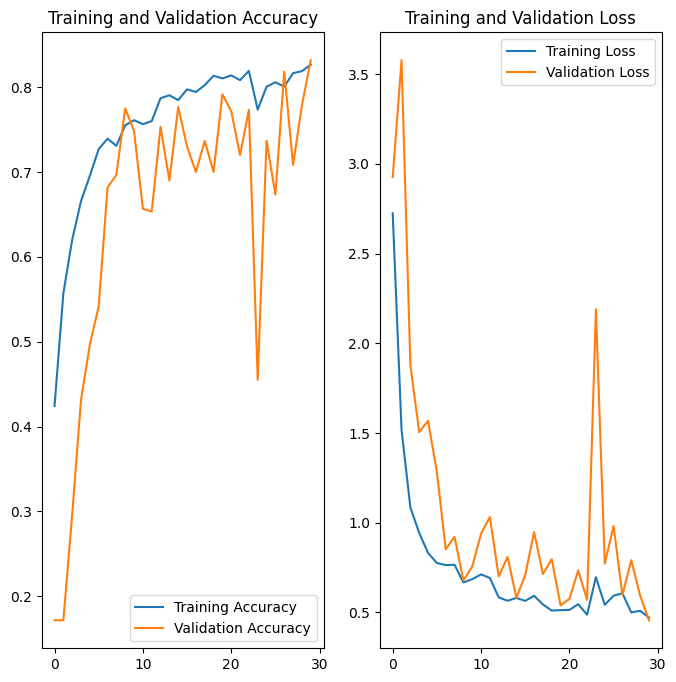

In [63]:
plot_fit(history, epochs=EPOCHS)

1/1 [==============================] - 0s 343ms/step
[[1.7826365e-04 9.9948907e-01 1.7344877e-05 2.8381564e-04 8.9080800e-07
  3.0556446e-05]]
1/1 [==============================] - 0s 26ms/step
[[3.2472913e-03 9.3793517e-01 2.8605240e-03 4.0647533e-02 7.6332642e-04
  1.4546120e-02]]
1/1 [==============================] - 0s 33ms/step
[[1.8303601e-04 9.9967933e-01 8.8071574e-05 4.7887614e-05 6.1687263e-07
  1.0918347e-06]]
1/1 [==============================] - 0s 32ms/step
[[2.0819052e-01 1.2647360e-05 2.7073929e-03 2.0456819e-04 1.0332466e-04
  7.8878152e-01]]
1/1 [==============================] - 0s 27ms/step
[[6.7252309e-05 1.4999864e-07 6.3904989e-01 3.6065659e-01 2.1828777e-04
  7.7792456e-06]]
1/1 [==============================] - 0s 28ms/step
[[9.6674758e-01 5.9885139e-07 7.4098111e-06 1.8702590e-06 6.4037163e-06
  3.3236075e-02]]
1/1 [==============================] - 0s 34ms/step
[[9.0902776e-01 1.5455825e-08 1.1107012e-03 4.4827731e-05 1.0281922e-03
  8.8788606e-02]]
1/1 [

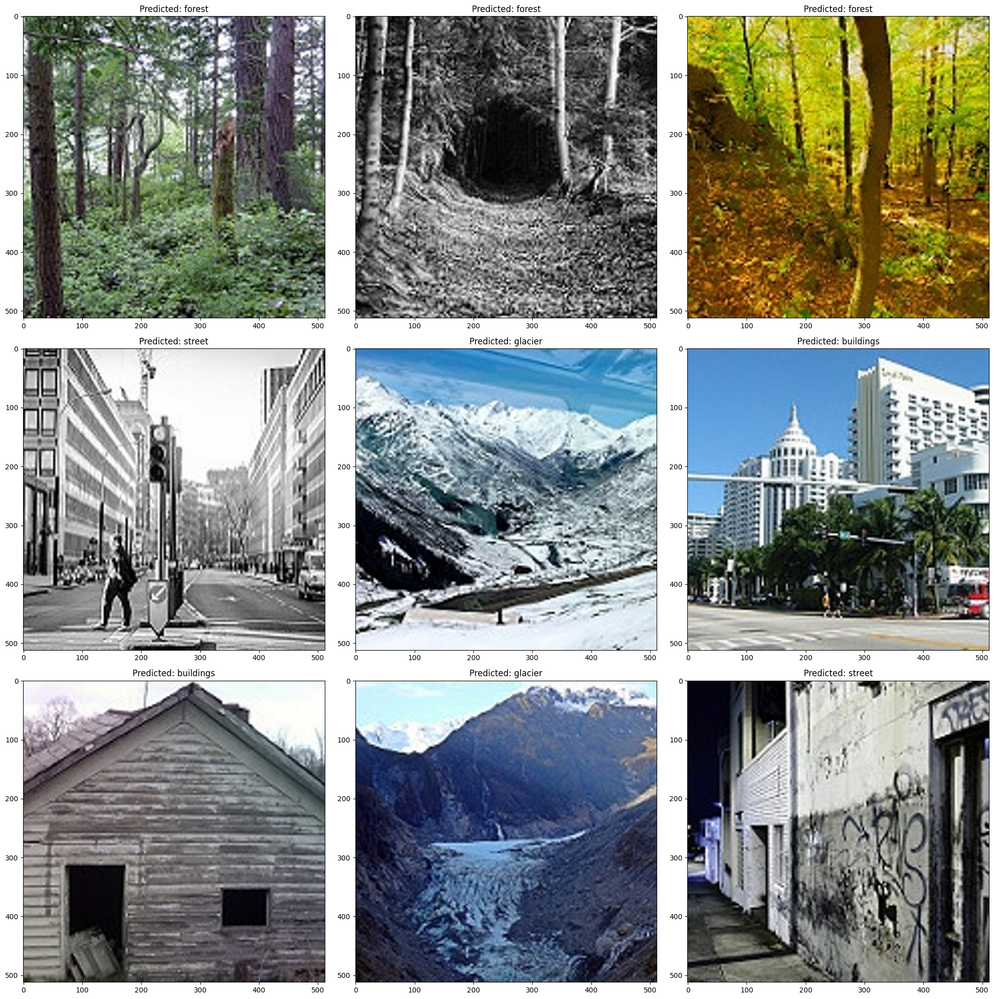

In [64]:
plot_predictions(
    resnet_model,
    PRED_IMAGES_DIRECTORY,
    class_names,
    sx=3,
    sy=3,
    figsize=(20, 20)
)

El modelo de ResNet muestra un rendimiento razonable para la clasificación. A lo largo de las 30 épocas, la precisión en el conjunto de entrenamiento alcanza el 81%, mientras que la precisión en el conjunto de validación llega al 79%. Estos resultados indican que el modelo tiene una capacidad decente para aprender y generalizar a datos no vistos, aunque hay margen de mejora.

Sin embargo, se observa un claro caso de sobreajuste y entrenamiento es intestable y con muchos picos. Esto sugiere que el modelo puede estar demasiado complejo para el conjunto de datos o que se requieren ajustes adicionales en la configuración, como la incorporación de regularización o una arquitectura de bloques residuales más profunda y cuidadosamente ajustada.

Dado que los bloques residuales pueden ser bastante sensibles a la configuración, una revisión detallada de la arquitectura y los hiperparámetros podría mejorar significativamente el rendimiento del modelo. Con la configuración actual, el modelo tiene un rendimiento aceptable, pero no superior al primero conformado por la combinación de capas densas y convolucionales.

## Modelo con backbone

In [65]:
!cat /content/aa2/ej3/transfer.py

import tensorflow as tf
from keras.layers import Input, GlobalAveragePooling2D, Dense
from keras.models import Model
from keras.applications import MobileNetV2
from keras.optimizers import Adam

def build_model(input_shape, output_labels):
    # Load the pre-trained MobileNetV2 model
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model.trainable = False

    # base arquitecture for model
    inputs = Input(shape=input_shape)
    x = base_model(inputs, training=False)
    x = GlobalAveragePooling2D()(x)
    outputs = Dense(output_labels, activation='softmax')(x)
    model = Model(inputs, outputs)
    return model


In [66]:
print("Building model Transfer Learning")
transfer_model = transfer.build_model(
    (IMAGE_HEIGHT, IMAGE_WIDTH, 3),
    num_classes
)

transfer_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])
transfer_model.summary()

Building model Transfer Learning
9406464/9406464 [==============================] - 0s 0us/step
Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 mobilenetv2_1.00_224 (Func  (None, 5, 5, 1280)        2257984   
 tional)                                                         
                                                                 
 global_average_pooling2d (  (None, 1280)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense_8 (Dense)             (None, 6)                 7686      
                                                                 
Total params: 2265670 (8.64 MB)
Trainable params: 7686 (30.02 KB)
Non-trainable params: 2257984

In [67]:
history = transfer_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/30
75/75 [==============================] - 17s 157ms/step - loss: 0.9977 - accuracy: 0.6078 - val_loss: 0.8033 - val_accuracy: 0.7050
Epoch 2/30
75/75 [==============================] - 8s 102ms/step - loss: 0.7376 - accuracy: 0.7201 - val_loss: 0.7101 - val_accuracy: 0.7583
Epoch 3/30
75/75 [==============================] - 9s 116ms/step - loss: 0.6690 - accuracy: 0.7513 - val_loss: 0.6784 - val_accuracy: 0.7683
Epoch 4/30
75/75 [==============================] - 9s 118ms/step - loss: 0.6337 - accuracy: 0.7634 - val_loss: 0.6602 - val_accuracy: 0.7817
Epoch 5/30
75/75 [==============================] - 8s 109ms/step - loss: 0.6065 - accuracy: 0.7784 - val_loss: 0.6503 - val_accuracy: 0.7833
Epoch 6/30
75/75 [==============================] - 8s 100ms/step - loss: 0.5870 - accuracy: 0.7846 - val_loss: 0.6231 - val_accuracy: 0.7933
Epoch 7/30
75/75 [==============================] - 9s 120ms/step - loss: 0.5651 - accuracy: 0.7902 - val_loss: 0.6160 - val_accuracy: 0.7967
Epoch

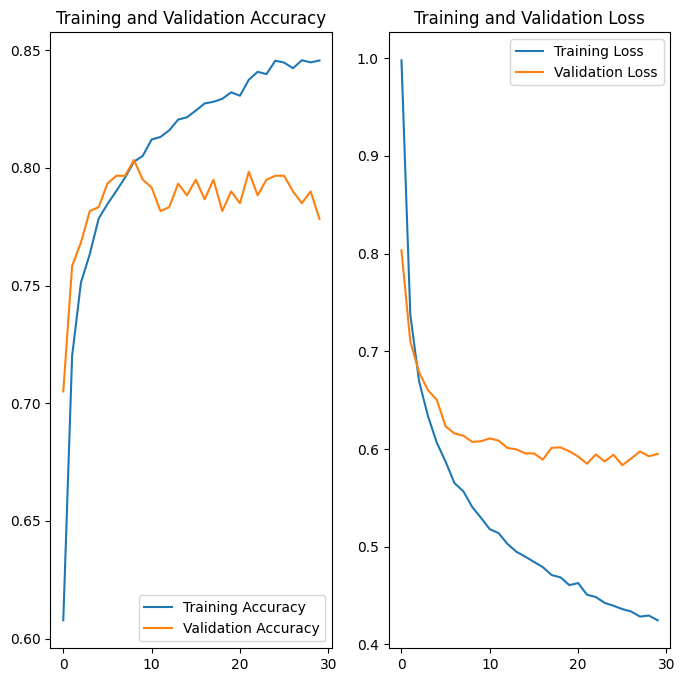

In [68]:
plot_fit(history, epochs=EPOCHS)

1/1 [==============================] - 1s 1s/step
[[3.6733935e-04 9.9919838e-01 3.5311947e-05 3.3224185e-04 4.1445051e-06
  6.2573323e-05]]
1/1 [==============================] - 0s 22ms/step
[[1.7820869e-06 9.9975854e-01 9.0040321e-06 2.0126257e-05 2.0429925e-05
  1.9020325e-04]]
1/1 [==============================] - 0s 22ms/step
[[2.3096576e-04 9.9751437e-01 1.6331569e-04 5.4272427e-04 4.3307571e-04
  1.1156272e-03]]
1/1 [==============================] - 0s 21ms/step
[[1.1865768e-01 9.8819495e-04 3.0303630e-03 6.8667106e-04 5.2201753e-03
  8.7141687e-01]]
1/1 [==============================] - 0s 23ms/step
[[2.5048197e-05 1.8585450e-05 8.8280553e-01 9.1227792e-02 2.5154149e-02
  7.6888670e-04]]
1/1 [==============================] - 0s 22ms/step
[[9.2334270e-01 3.2411353e-04 5.3144097e-03 3.6345422e-02 8.0114594e-03
  2.6661897e-02]]
1/1 [==============================] - 0s 26ms/step
[[6.0737687e-01 5.9387014e-05 8.5857645e-02 2.7048907e-01 1.8663080e-02
  1.7554028e-02]]
1/1 [===

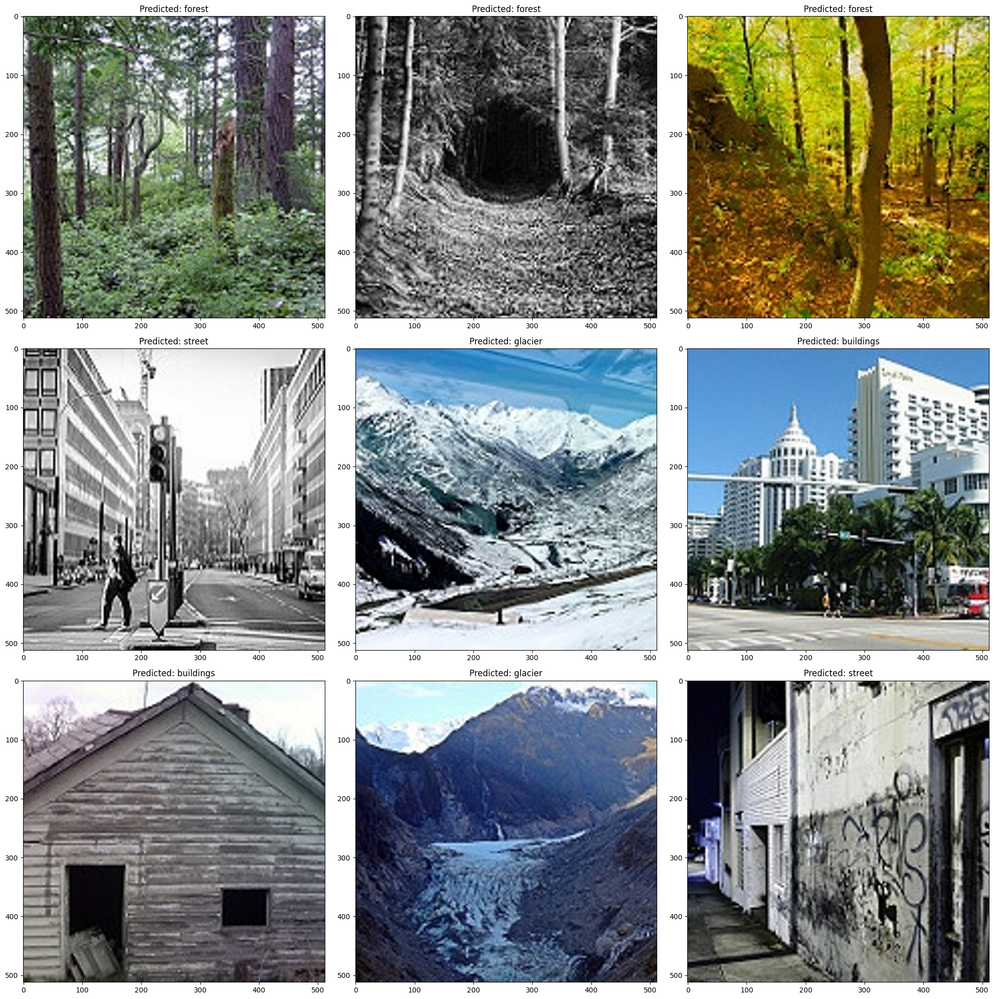

In [69]:
plot_predictions(
    transfer_model,
    PRED_IMAGES_DIRECTORY,
    class_names,
    sx=3,
    sy=3,
    figsize=(20, 20)
)

El modelo que usa otro modelo pre-entrenado, en este caso MobileNetV2, utilizando tecnicas de transfer learning, notamos un rendimiento levemente superior al modelo basado en capas densas y convolucionales.

Se consigue un entramiento muy estable y relativamente balanceado con una presición del 80% para la epoca 12, por lo que se demuestra que de una arquitectura muy sencilla, ya que la complejidad y entramiento se hererda, se puede obtener un modelo de clasificacion de imagenes eficiente.

Ademas se consigue que el modelo converga mucho mas rapido, con tan solo 10 epocas ya se consiguen resultados aceptables para esta tarea.

Luego de estas 10/12 eopcas, el modelo comienza a sobreajustar el entrenamiento significativamente, por lo que es recomendable mantener el este modelo con un entrenamiento de 12 epocas, para asegurar una capacidad de generalizacion en las predicciones.